
# 矩形水池內的三維波浪共振模擬

此 Jupyter Notebook 展示了矩形水池內波浪共振的三維模擬。模擬使用 `matplotlib` 的 `plot_surface` 繪製動態三維曲面圖，並通過 `FuncAnimation` 實現動畫效果。

In [1]:

# 匯入所需程式庫
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from mpl_toolkits.mplot3d import Axes3D
    


## 模擬參數設定

以下是矩形水池、波浪模式及動畫的參數設定，您可以根據需要進行調整：
- `Lx`, `Ly`：水池的長度和寬度。
- `Nx`, `Ny`：模擬網格的解析度。
- `mode_x`, `mode_y`：波浪在 x 和 y 方向的模式數。
- `omega`：波浪的角頻率。
- `T`, `fps`：動畫的總時長及每秒幀數。
    

In [2]:

# 模擬參數
Lx = 2.0  # 水池在 x 方向的長度 (公尺)
Ly = 1.0  # 水池在 y 方向的寬度 (公尺)
Nx = 100  # x 方向的網格點數
Ny = 50   # y 方向的網格點數
T = 5.0  # 動畫時長 (秒)
fps = 30  # 每秒幀數

# 波浪參數
mode_x = 2  # x 方向的波浪模式數
mode_y = 1  # y 方向的波浪模式數
omega = 2 * np.pi  # 角頻率 (弧度每秒)
    


## 建立網格並初始化繪圖

以下程式碼建立三維曲面繪圖所需的網格，並初始化靜態波浪圖形。
    

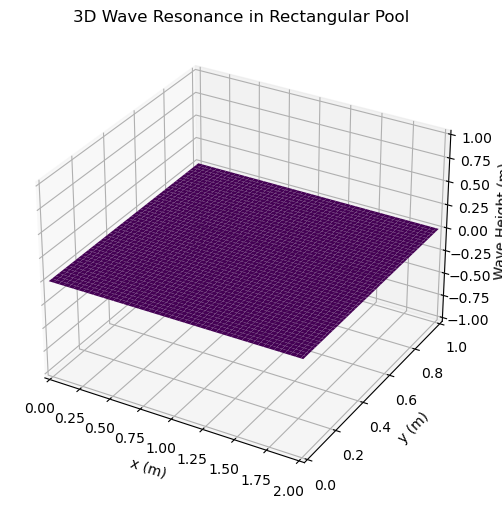

In [3]:

# 建立網格
x = np.linspace(0, Lx, Nx)
y = np.linspace(0, Ly, Ny)
X, Y = np.meshgrid(x, y)

# 初始化繪圖
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')
ax.set_xlim(0, Lx)
ax.set_ylim(0, Ly)
ax.set_zlim(-1, 1)
ax.set_xlabel("x (m)")
ax.set_ylabel("y (m)")
ax.set_zlabel("Wave Height (m)")
ax.set_title("3D Wave Resonance in Rectangular Pool")

# 初始化曲面
Z = np.zeros_like(X)
wave_surface = [ax.plot_surface(X, Y, Z, cmap='viridis', edgecolor='none')]
    


## 定義動畫函數

動畫函數基於以下波浪方程更新波浪曲面：
$$
Z(x, y, t) = \sin\left(\frac{m \pi x}{L_x} \right) \sin\left(\frac{n \pi y}{L_y} \right) \cos(\omega t)
$$
    

In [4]:

# 動畫更新函數
def update(frame):
    t = frame / fps
    Z = np.sin(mode_x * np.pi * X / Lx) * np.sin(mode_y * np.pi * Y / Ly) * np.cos(omega * t)
    wave_surface[0].remove()  # 移除舊的曲面
    wave_surface[0] = ax.plot_surface(X, Y, Z, cmap='viridis', edgecolor='none')
    return wave_surface[0],
    


## 創建動畫

使用 `FuncAnimation` 創建動畫，並根據總時長和幀數計算總幀數。
    

In [5]:

# 創建動畫
num_frames = int(T * fps)
ani = FuncAnimation(fig, update, frames=num_frames, blit=False)
    


## 顯示動畫
    

In [6]:

# 顯示動畫
from IPython.display import HTML
HTML(ani.to_jshtml())   

Animation size has reached 21015811 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
